In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!export PROJECT_HOME="/content/drive/MyDrive/Study/ml/chest_gan"

In [ ]:
!pip install --quiet "pytorch_lightning==1.7.7" "ipykernel==6.15.3" "ipython[notebook]" "torchmetrics>=0.7" "setuptools==59.5.0"

     |████████████████████████████████| 708 kB 36.7 MB/s 
     |████████████████████████████████| 138 kB 79.4 MB/s 
     |████████████████████████████████| 512 kB 75.0 MB/s 
     |████████████████████████████████| 952 kB 80.5 MB/s 
     |████████████████████████████████| 423 kB 78.7 MB/s 
     |████████████████████████████████| 761 kB 75.8 MB/s 
     |████████████████████████████████| 386 kB 79.6 MB/s 
     |████████████████████████████████| 1.6 MB 62.3 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires ipykernel~=5.3.4, but you have ipykernel 6.15.3 which is incompatible.
google-colab 1.0.0 requires ipython~=7.9.0, but you have ipython 8.7.0 which is incompatible.
google-colab 1.0.0 requires tornado~=6.0.4, but you have tornado 6.2 which is incompatible.


In [ ]:
import os

import random

import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim.lr_scheduler as lr_shed
import torchvision
import torchvision.transforms as transforms
import torchvision.datasets as dset

from pytorch_lightning import LightningDataModule, LightningModule, Trainer
from pytorch_lightning.callbacks.progress import TQDMProgressBar
from pytorch_lightning.loggers import TensorBoardLogger
from torch.utils.data import DataLoader, random_split

import torchvision.utils as vutils
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML


LOGGER_PATH = os.environ.get("PROJECT_HOME", "/content/drive/MyDrive/Study/ml/chest_gan") 
PATH_DATASETS = os.environ.get("PATH_DATASETS", "/content/CellData/chest_xray/train/")
BATCH_SIZE = 16 if torch.cuda.is_available() else 32
NUM_WORKERS = int(os.cpu_count() / 2)

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
random.seed(manualSeed)
torch.manual_seed(manualSeed)

In [ ]:
# Load dataset
# https://zhanggroup.org/
!wget https://data.mendeley.com/datasets/rscbjbr9sj/3/files/810b2ce2-11c3-4424-996e-3bef36600907/ZhangLabData.zip
!unzip -q /content/ZhangLabData.zip # -q
!cp -r /content/CellData/chest_xray/test/NORMAL/*.jpeg /content/CellData/chest_xray/train/NORMAL/
!cp -r /content/CellData/chest_xray/test/PNEUMONIA/*.jpeg /content/CellData/chest_xray/train/PNEUMONIA/

--2022-12-15 10:07:16--  https://data.mendeley.com/datasets/rscbjbr9sj/3/files/810b2ce2-11c3-4424-996e-3bef36600907/ZhangLabData.zip
Resolving data.mendeley.com (data.mendeley.com)... 162.159.130.86, 162.159.133.86
Connecting to data.mendeley.com (data.mendeley.com)|162.159.130.86|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /v1/datasets/rscbjbr9sj/3/files/810b2ce2-11c3-4424-996e-3bef36600907/ZhangLabData.zip [following]
--2022-12-15 10:07:17--  https://data.mendeley.com/v1/datasets/rscbjbr9sj/3/files/810b2ce2-11c3-4424-996e-3bef36600907/ZhangLabData.zip
Reusing existing connection to data.mendeley.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://prod-dcd-datasets-public-files-eu-west-1.s3.eu-west-1.amazonaws.com/e9a18c27-67da-40a2-8f48-1c12f03de39d [following]
--2022-12-15 10:07:18--  https://prod-dcd-datasets-public-files-eu-west-1.s3.eu-west-1.amazonaws.com/e9a18c27-67da-40a2-8f48-1c12f03de39d
Resolving prod-d

In [ ]:
# Number of workers for dataloader
workers = 4

# Batch size during training
batch_size = 8

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

In [ ]:
class MNISTDataModule(LightningDataModule):
    def __init__(self, 
                 data_dir: str = PATH_DATASETS,
                 batch_size: int = BATCH_SIZE,
                 num_workers: int = NUM_WORKERS,
    ):
        super().__init__()
        self.data_dir = data_dir
        self.batch_size = batch_size
        self.num_workers = num_workers
        self.transform = transforms.Compose(
            [
                transforms.Resize(image_size),
                # transforms.Grayscale(1),
                transforms.CenterCrop(image_size),
                transforms.ToTensor(),
                transforms.Normalize((0.5), (0.5)),
            ]
        )
        self.dims = (nc, image_size, image_size)
        self.num_classes = 2

    def prepare_data(self):
        # download
        if not os.path.exists("/content/CellData/chest_xray/train/"):
            # wget --TODO--
            pass


    def setup(self, stage: str = None):
        # Assign train/val datasets for use in dataloaders
        self.chest_train = dset.ImageFolder(
                                            root=self.data_dir,
                                            transform=self.transform
                                            )

    def train_dataloader(self):
        return DataLoader(
            self.chest_train,
            batch_size=self.batch_size,
            shuffle=True,
            num_workers=self.num_workers,
        )

    def train_dataloader_with_batch(self, batch_size_custom):
        return DataLoader(
            self.chest_train,
            batch_size=batch_size_custom,
            shuffle=True,
            num_workers=self.num_workers,
        )

    def __len__(self):
      return len(self.chest_train)

In [ ]:
dataroot = "/content/CellData/chest_xray/train/" # '/content/CellData/chest_xray/train/NORMAL/'

In [ ]:
# Custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
class Generator(nn.Module):
    def __init__(self, latent_dim, img_shape):
        super(Generator, self).__init__()
        self.img_shape = img_shape
        self.latent_dim = latent_dim

        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(self.latent_dim, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )
        weights_init(self)

    def forward(self, input):
        return self.main(input)

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, img_shape):
        super(Discriminator, self).__init__()

        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )
        weights_init(self)

    def forward(self, input):
        return self.main(input)

In [ ]:
# randn -> rand.

# Establish convention for real and fake labels during training
real_label = 1.0
fake_label = 0.0


class GAN(LightningModule):
    def __init__(
        self,
        channels,
        width,
        height,
        latent_dim: int = nz,
        lr_g: float = 2e-4, # 0.0002,
        lr_d: float = 9e-4, # 0.0009,
        b1: float = 0.5,
        b2: float = 0.999,
        batch_size: int = BATCH_SIZE,
        max_epochs: int = 5,
        **kwargs,
    ):
        super().__init__()
        self.save_hyperparameters()
        print(self.hparams)
        # networks
        data_shape = (channels, width, height)
        self.generator = Generator(latent_dim=self.hparams.latent_dim, img_shape=data_shape)
        self.discriminator = Discriminator(img_shape=data_shape)
        self.max_epochs = max_epochs
        print(self.generator)
        print(self.discriminator)
        self.html_img_list = []
        self.gen_fixed_noise = True
        self.fixed_noise = None

    def forward(self, z):
        return self.generator(z)

    def adversarial_loss(self, y_hat, y):
        return F.binary_cross_entropy(y_hat, y)

    def training_step(self, batch, batch_idx, optimizer_idx):
        imgs, _ = batch

        # train generator
        if optimizer_idx == 0:

            noise = torch.randn(imgs.shape[0], self.hparams.latent_dim, 1, 1).type_as(imgs)
            # ((torch.rand(imgs.shape[0], self.hparams.latent_dim)-0.5)/0.5).type_as(imgs)

            # generate images
            fake_inputs = self.generator(noise)
            fake_outputs = self.discriminator(fake_inputs)
            fake_targets = torch.ones([fake_inputs.shape[0], 1, 1, 1]).type_as(imgs)

              # log sampled images
            if batch_idx == 0:
                sample_imgs = fake_inputs[:6]
                grid = torchvision.utils.make_grid(sample_imgs, padding=5, normalize=True)  # check experimental after this one
                self.logger.experiment.add_image(f"generated_images_epoch_{self.current_epoch}", grid, 0)
                if self.gen_fixed_noise:
                    self.fixed_noise = torch.randn(64, nz, 1, 1).type_as(imgs)
                    self.gen_fixed_noise = False

            # ground truth result (ie: all fake)
            # put on GPU because we created this tensor inside training_loop

            # adversarial loss is binary cross-entropy
            g_loss = self.adversarial_loss(fake_outputs, fake_targets)
            self.log("g_loss", g_loss, prog_bar=True)
            return g_loss

        # train discriminator
        # Real inputs are actual images of the MNIST dataset
        # Fake inputs are from the generator
        # Real inputs should be classified as 1 and fake as 0
        if optimizer_idx == 1:

            noise = torch.randn(imgs.shape[0], self.hparams.latent_dim, 1, 1).type_as(imgs)
            # ((torch.rand(imgs.shape[0], self.hparams.latent_dim, 1)-0.5)/0.5).type_as(imgs)  #        noise = torch.randn(b_size, nz, 1, 1, device=device)
            # noise = noise.type_as(imgs)

            # Measure discriminator's ability to classify real from generated samples
            real_inputs = imgs
            real_outputs = self.discriminator(real_inputs)
            real_label = torch.ones(real_inputs.shape[0], 1, 1, 1).type_as(imgs) # real_label
            #real_label = real_label.type_as(imgs)

            fake_inputs = self.generator(noise)
            fake_outputs = self.discriminator(fake_inputs)
            fake_label = torch.zeros(fake_inputs.shape[0], 1, 1, 1).type_as(imgs) # fake_label
            #fake_label = fake_label.type_as(imgs)

            # d_loss_real = self.adversarial_loss(real_outputs, real_label)
            # d_loss_fake = self.adversarial_loss(fake_outputs, fake_label)
            # d_loss = (d_loss_real + d_loss_fake) # / 2
            
            outputs = torch.cat((real_outputs, fake_outputs), 0)
            targets = torch.cat((real_label, fake_label), 0)
            d_loss = self.adversarial_loss(outputs, targets)

            self.log("d_loss", d_loss, prog_bar=True)
            return d_loss

    def configure_optimizers(self):
        lr_g = self.hparams.lr_g
        lr_d = self.hparams.lr_d
        b1 = self.hparams.b1
        b2 = self.hparams.b2

        opt_g = torch.optim.Adam(self.generator.parameters(), lr=lr_g, betas=(b1, b2))
        opt_d = torch.optim.Adam(self.discriminator.parameters(), lr=lr_d, betas=(b1, b2))
        gen_sch = {
            'scheduler': lr_shed.ExponentialLR(opt_g, 0.99),
            'interval': 'epoch'  # called after each training epoch
        }
        dis_sch = {
            'scheduler': lr_shed.ExponentialLR(opt_d, 0.99),
            'interval': 'epoch'  # called after each training epoch
            # 'scheduler': lr_shed.CosineAnnealingLR(opt_d, T_max=5000/BATCH_SIZE/10),
            # 'interval': 'step'  # called after each training step
        }
        return [opt_g, opt_d], [gen_sch, dis_sch]

    def _save_models(self, path):
        torch.save(self.generator, path + "/generator.pth")
        torch.save(self.discriminator, path + "/discriminator.pth")
        return

    def on_train_epoch_end(self):
        if self.max_epochs > 10:
            if self.current_epoch in [int(self.max_epochs * p - 1) for p in [.2, .4, .6, .8, 1.0]]:
                model_path = LOGGER_PATH + f"/models/save_model_{self.current_epoch}"
                if not os.path.exists(model_path):
                    os.makedirs(model_path)
                self._save_models(model_path)
                # also save images to htlm format
                self.html_img_list.append(vutils.make_grid(self.generator(self.fixed_noise), padding=2, normalize=True))
        else:
            if self.current_epoch == self.max_epochs - 1:
                model_path = LOGGER_PATH + f"/models/save_model_{self.current_epoch}"
                if not os.path.exists(model_path):
                    os.makedirs(model_path)
                self._save_models(model_path)
        return

In [ ]:
MAX_EPOCH = 70
MODEL_NAME = f"chest_gan_maxepoch{MAX_EPOCH}"

dm = MNISTDataModule()
model = GAN(*dm.dims, max_epochs=MAX_EPOCH)
tblogger = TensorBoardLogger(LOGGER_PATH + "/tb_log/", name=MODEL_NAME)
trainer = Trainer(
    accelerator="auto",
    devices=1 if torch.cuda.is_available() else None,  # limiting got iPython runs
    max_epochs=MAX_EPOCH,
    callbacks=[TQDMProgressBar(refresh_rate=20)],
    logger=tblogger,
)
trainer.fit(model, train_dataloaders=dm)

"b1":         0.5
"b2":         0.999
"batch_size": 16
"channels":   3
"height":     64
"latent_dim": 100
"lr_d":       0.0009
"lr_g":       0.0002
"max_epochs": 70
"width":      64
Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affin

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name          | Type          | Params
------------------------------------------------
0 | generator     | Generator     | 3.6 M 
1 | discriminator | Discriminator | 2.8 M 
------------------------------------------------
6.3 M     Trainable params
0         Non-trainable params
6.3 M     Total params
25.369    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=70` reached.


In [ ]:
!echo "$LOGGER_PATH/tb_log/"

/content/drive/MyDrive/Study/ml/chest_gan/tb_log/


In [ ]:
%tensorboard --logdir /content/drive/MyDrive/Study/ml/chest_gan/tb_log/

<IPython.core.display.Javascript object>

In [ ]:
%load_ext tensorboard
%tensorboard --logdir "$LOGGER_PATH/tb_log/"  # "/content/drive/MyDrive/Study/ml/chest_gan/tb_log/"

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 305), started 0:00:54 ago. (Use '!kill 305' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
%reload_ext tensorboard

In [ ]:
img_list = []
img_list.append(vutils.make_grid(model.generator(model.fixed_noise.to(device="cpu")), padding=2, normalize=True))

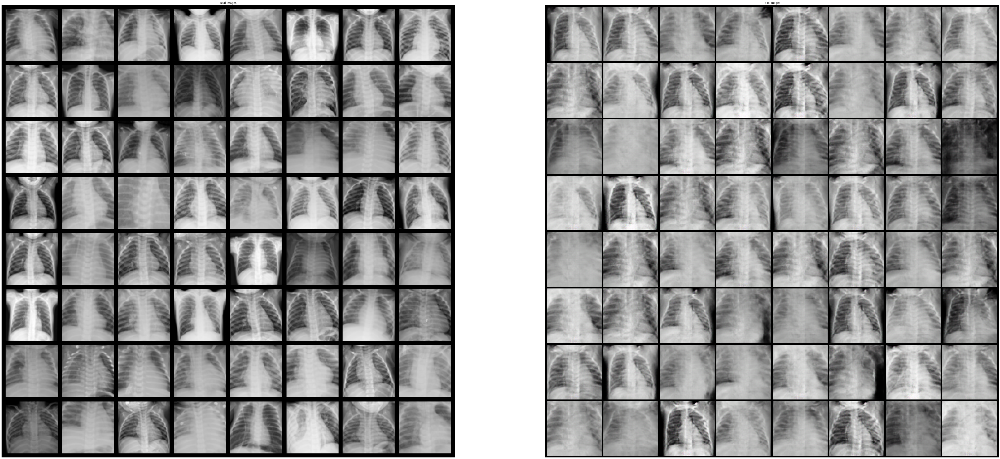

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dm.train_dataloader_with_batch(64)))

# Plot the real images
plt.figure(figsize=(80,80))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0][:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

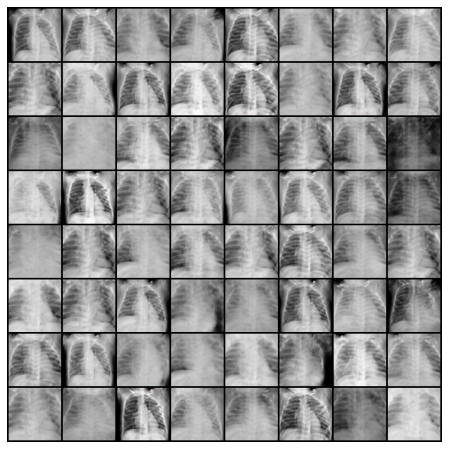

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i.to(device="cpu"),(1,2,0)), animated=True)] for i in model.html_img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())